In [31]:
import tensorflow as tf
from tensorflow.keras import models, layers
from tensorflow import keras
import kerastuner as kt
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from astropy import stats
from skimage.transform import resize
from scipy.ndimage import rotate # could use skimage rotate
import sys
import time
from pathlib import Path
from IPython import display
from astropy.io import fits 
from scipy.ndimage import rotate
import glob
from tqdm.notebook import tqdm
import random
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import seaborn as sn
import pandas as pd
import os

In [87]:
def show_images(images, num):
    """
    Visualising the images
    """
    cols = 3
    rows = (num+cols-1)//cols
    plt.figure(figsize=(cols*4, rows*4))
    for i in range(num):
        ax = plt.subplot(rows, cols, i+1)
        image = images[i]
        plt.imshow(image)
        plt.axis('off')
    plt.savefig(r'Report images/image_prep.png', dpi=300, bbox_inches='tight')
    plt.show() 

In [7]:
files1 = glob.glob(r'Raw Data\Filaments\cut*')

In [71]:
array = np.empty([3, 128, 128])

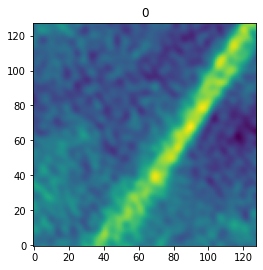

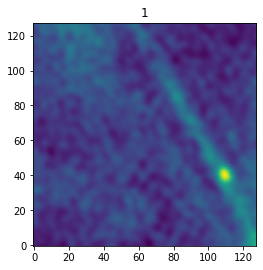

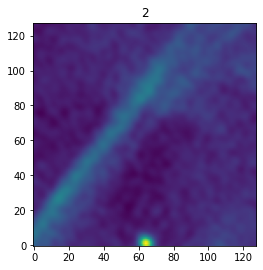

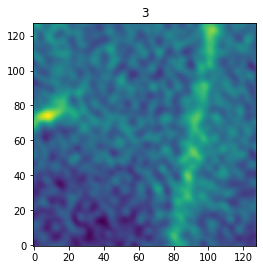

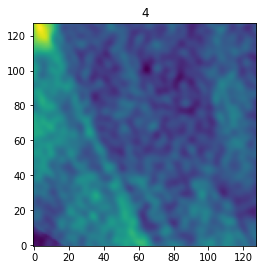

...

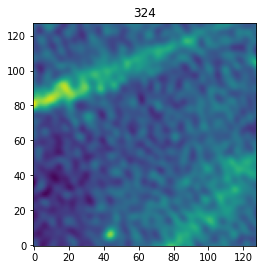

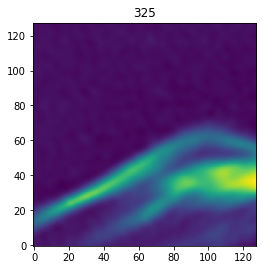

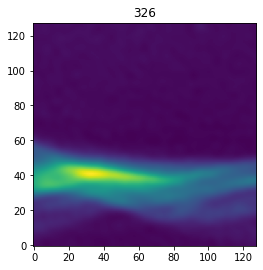

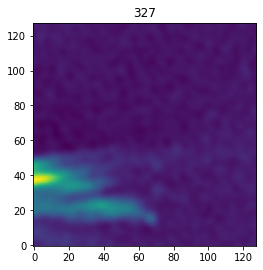

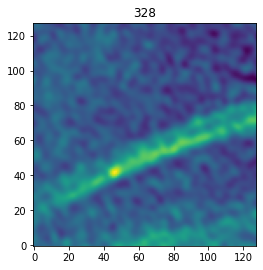

In [23]:
for i in range(len(files1)):
    file = files1[i]
    
    hdu = fits.open(file)[0]
    plt.figure(figsize=(4,6))
    plt.imshow(hdu.data, origin='lower')
    plt.title(i)
    plt.show()

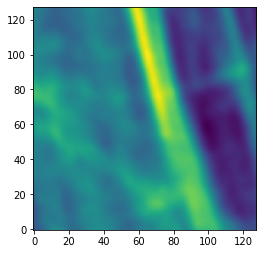

In [72]:
file = files1[33]
hdu = fits.open(file)[0]
image = hdu.data
plt.figure(figsize=(4,6))
plt.imshow(image, origin='lower') 
plt.show()

In [73]:
array[0] = image

In [74]:
sigma=1
mean, median, std = stats.sigma_clipped_stats(image, sigma=sigma)
image[image < median+sigma*std] = median+sigma*std

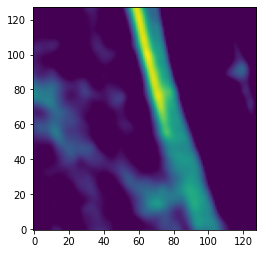

In [75]:
plt.figure(figsize=(4,6))
plt.imshow(image, origin='lower') 
plt.show()

In [76]:
image = 2*((image-np.min(image))/np.ptp(image))-1

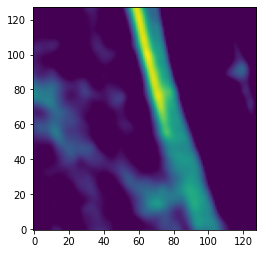

In [77]:
plt.figure(figsize=(4,6))
plt.imshow(image, origin='lower') 
plt.show()

In [78]:
array[1] = image

In [79]:
mean_n, median_n, std_n = stats.sigma_clipped_stats(image, sigma=sigma)
image = rotate(image,  np.random.uniform(0, 180), reshape=False, cval = median_n)

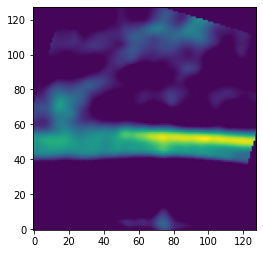

In [80]:
plt.figure(figsize=(4,6))
plt.imshow(image, origin='lower') 
plt.show()

In [81]:
array[2] = image

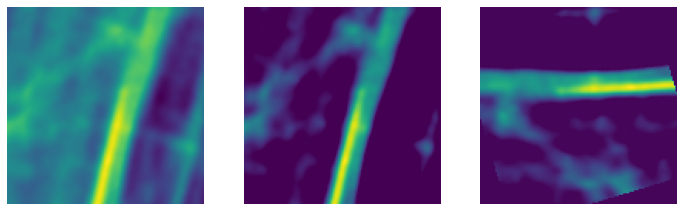

In [88]:
show_images(array,3)

In [85]:
image